<a href="https://colab.research.google.com/github/pouriazzz/jupyter_files/blob/main/Copy_of_vgg16-gradcam.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')
train_path = "/content/drive/MyDrive/RGBS/Train"
test_path = "/content/drive/MyDrive/RGBS/Test"
validation_path = "/content/drive/MyDrive/RGBS/Validation"
# train_path = "/content/drive/MyDrive/RGBS/Train"
# test_path = "/content/drive/MyDrive/RGBS/Test"
# validation_path = "/content/drive/MyDrive/RGBS/Validation"

# train_path = "E:\\RGBS\\RGBS\\Train"
# test_path = "E:\\RGBS\\RGBS\\Test"
# validation_path = "E:\\RGBS\\RGBS\\Validation"

Mounted at /content/drive


In [ ]:
import matplotlib.pyplot as plt
import keras
from keras.models import Sequential
from keras.layers import Dense, Conv2D , MaxPool2D , Flatten , Dropout
from keras.preprocessing.image import ImageDataGenerator
from keras.optimizers import Adam
from sklearn.metrics import classification_report,confusion_matrix
import tensorflow as tf
import cv2
import os
import numpy as np

In [ ]:
test = keras.utils.image_dataset_from_directory(
                          directory=test_path,
                          labels="inferred",
                          label_mode="binary",
                          class_names=["Benign","Malware"],
                          batch_size=32,
                          image_size=(256, 256),
                          shuffle=True,
                          seed=None,
                          validation_split=None,
                          subset=None,
                          interpolation="bilinear",
                          follow_links=False,
                          crop_to_aspect_ratio=False,

)

Found 2482 files belonging to 2 classes.


In [ ]:
train = keras.utils.image_dataset_from_directory(
                          directory=train_path,
                          labels="inferred",
                          label_mode="binary",
                          class_names=["Benign","Malware"],
                          batch_size=32,
                          image_size=(256, 256),
                          shuffle=True,
                          seed=None,
                          validation_split=None,
                          subset=None,
                          interpolation="bilinear",
                          follow_links=False,
                          crop_to_aspect_ratio=False,

)

Found 8715 files belonging to 2 classes.


In [ ]:
validation = keras.utils.image_dataset_from_directory(
                          directory=validation_path,
                          labels="inferred",
                          label_mode="binary",
                          class_names=["Benign","Malware"],
                          batch_size=32,
                          image_size=(256, 256),
                          shuffle=True,
                          seed=None,
                          validation_split=None,
                          subset=None,
                          interpolation="bilinear",
                          follow_links=False,
                          crop_to_aspect_ratio=False,

)

Found 1240 files belonging to 2 classes.


In [ ]:
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.applications.vgg16 import preprocess_input
base_model = VGG16(weights="imagenet", include_top=False, input_shape=(256,256,3))
base_model.trainable = True


58889256/58889256 [==============================] - 0s 0us/step


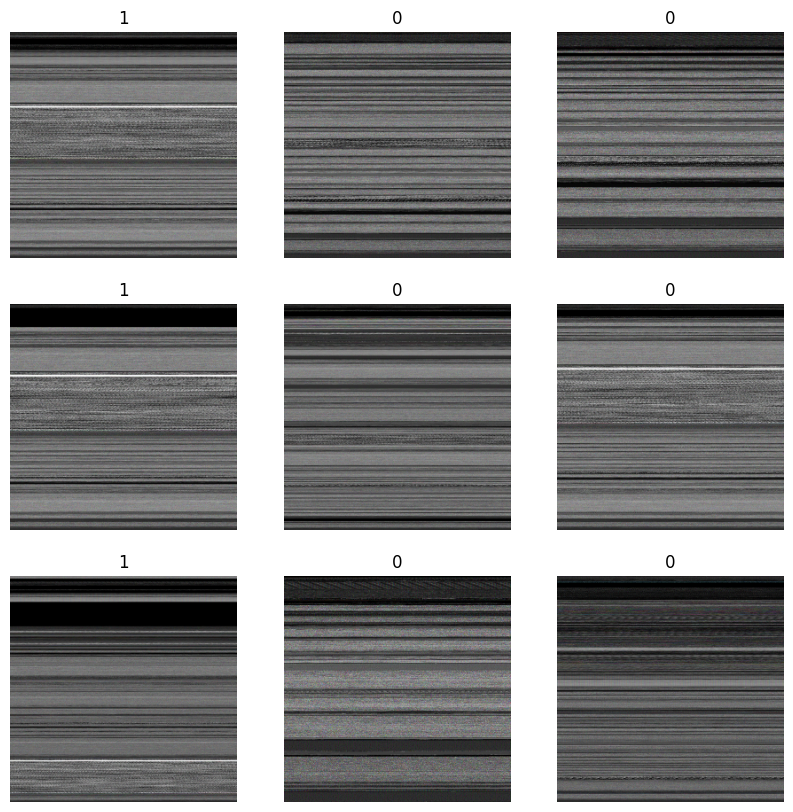

In [ ]:
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 10))
for images, labels in train.take(1):
    for i in range(9):
        ax = plt.subplot(3, 3, i + 1)
        plt.imshow(images[i].numpy().astype("uint8"))
        plt.title(int(labels[i]))
        plt.axis("off")

In [ ]:
def process(image,label):
    image = tf.cast(image/255. ,tf.float32)
    return image,label

train = train.map(process)
test = test.map(process)

In [ ]:
# from keras import regularizers


# model = Sequential()
# model.add(Conv2D(32,kernel_size=(3,3),padding="same", activation="relu", input_shape=(256,256,3)))
# model.add(Conv2D(64,(3,3), padding="same", activation="relu"))
# model.add(MaxPool2D(pool_size=(2,2)))
# model.add(Dropout(0.25))

# model.add(Conv2D(128, (3,3), padding="same", activation="relu"))
# model.add(MaxPool2D(pool_size=(2,2)))
# model.add(Dropout(0.25))


# model.add(Conv2D(256, (3,3), padding="same", activation="relu"))
# model.add(MaxPool2D(pool_size=(2,2)))
# model.add(Dropout(0.25))

# model.add(Flatten())
# model.add(Dense(64,activation="relu"))
# model.add(Dropout(0.5))
# model.add(Dense(1, activation="sigmoid"))

# model.summary()




In [ ]:
flatten_layer = Flatten()
# dense_layer_1 = Dense(50, activation='relu')
# dense_layer_2 = Dense(20, activation='relu')
prediction_layer = Dense(1, activation='sigmoid')


model = Sequential([
    base_model,
    flatten_layer,
    prediction_layer
])
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 vgg16 (Functional)          (None, 8, 8, 512)         14714688  
                                                                 
 flatten (Flatten)           (None, 32768)             0         
                                                                 
 dense (Dense)               (None, 1)                 32769     
                                                                 
Total params: 14747457 (56.26 MB)
Trainable params: 14747457 (56.26 MB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


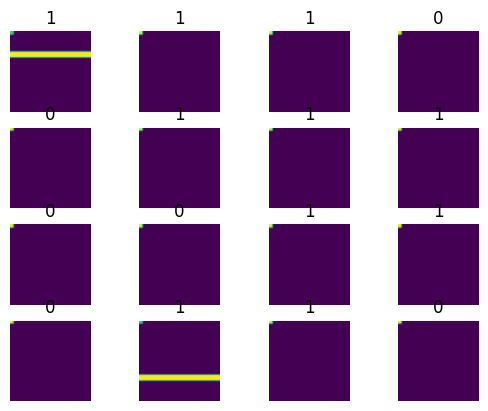

In [ ]:
import cv2
from google.colab.patches import cv2_imshow
imgs = []
label = []
for images, labels in train.take(1):
    for i in range(16):
        plt.subplot(4, 4, i + 1)
        # plt.imshow(images[i].numpy().astype("uint8"))
        plt.title(int(labels[i]))
        plt.axis("off")
        saliency = cv2.saliency.StaticSaliencySpectralResidual_create()
        (success, saliencyMap) = saliency.computeSaliency(images[i].numpy().astype("uint8"))
        saliencyMap = (saliencyMap * 255).astype("uint8")
        # plt.imshow(images[i].numpy().astype("uint8"))
        plt.imshow(saliencyMap)


In [ ]:
from tensorflow.keras.callbacks import EarlyStopping
opt = keras.optimizers.RMSprop(learning_rate=0.001)
model.compile(optimizer = opt , loss = "binary_crossentropy" , metrics = ['accuracy'])
es = EarlyStopping(monitor='val_accuracy', mode='max', patience=5,  restore_best_weights=True)

In [ ]:
history = model.fit(train, epochs=20, validation_data= test, batch_size=32, callbacks=[es])

Epoch 1/20
273/273 [==============================] - 1905s 7s/step - loss: 0.3254 - accuracy: 0.8695 - val_loss: 0.2239 - val_accuracy: 0.9146
Epoch 2/20
273/273 [==============================] - 164s 596ms/step - loss: 0.2453 - accuracy: 0.9071 - val_loss: 0.2059 - val_accuracy: 0.9218
Epoch 3/20
273/273 [==============================] - 163s 593ms/step - loss: 0.2057 - accuracy: 0.9192 - val_loss: 0.1923 - val_accuracy: 0.9283
Epoch 4/20
273/273 [==============================] - 162s 591ms/step - loss: 0.1853 - accuracy: 0.9263 - val_loss: 0.1880 - val_accuracy: 0.9279
Epoch 5/20
273/273 [==============================] - 163s 592ms/step - loss: 0.1689 - accuracy: 0.9359 - val_loss: 0.2025 - val_accuracy: 0.9251
Epoch 6/20
273/273 [==============================] - 162s 590ms/step - loss: 0.1572 - accuracy: 0.9377 - val_loss: 0.1835 - val_accuracy: 0.9323
Epoch 7/20
273/273 [==============================] - 162s 591ms/step - loss: 0.1355 - accuracy: 0.9481 - val_loss: 0.1910 - v

In [ ]:
vggmode = tf.keras.models.load_model('/content/drive/MyDrive/vgg16')

In [ ]:
model.save("/content/drive/MyDrive/vgg16")

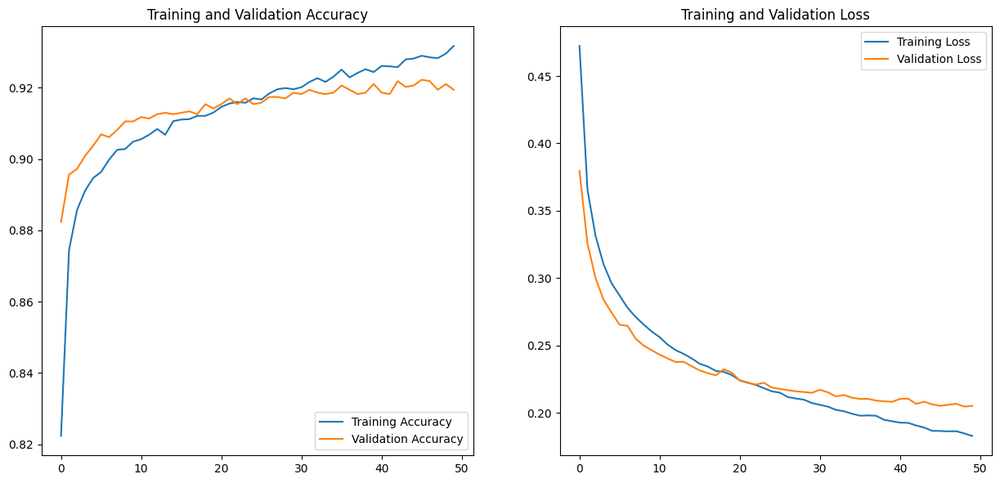

In [ ]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']
loss = history.history['loss']
val_loss = history.history['val_loss']

epochs_range = range(50)

plt.figure(figsize=(15, 15))
plt.subplot(2, 2, 1)
plt.plot(epochs_range, acc, label='Training Accuracy')
plt.plot(epochs_range, val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')

plt.subplot(2, 2, 2)
plt.plot(epochs_range, loss, label='Training Loss')
plt.plot(epochs_range, val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')
plt.show()

In [ ]:
from tensorflow.keras.models import Model

class GradCAM:
    def __init__(self, model, classIdx, layerName=None):
        # store the model, the class index used to measure the class
        # activation map, and the layer to be used when visualizing
        # the class activation map
        self.model = model
        self.classIdx = classIdx
        self.layerName = layerName
        # if the layer name is None, attempt to automatically find
        # the target output layer
        if self.layerName is None:
            self.layerName = self.find_target_layer()

    def find_target_layer(self):
        # attempt to find the final convolutional layer in the network
        # by looping over the layers of the network in reverse order
        for layer in reversed(self.model.layers):
            # check to see if the layer has a 4D output
            if len(layer.output_shape) == 4:
                return layer.name
        # otherwise, we could not find a 4D layer so the GradCAM
        # algorithm cannot be applied
        raise ValueError("Could not find 4D layer. Cannot apply GradCAM.")


    def compute_heatmap(self, image, eps=1e-8):
        # construct our gradient model by supplying (1) the inputs
        # to our pre-trained model, (2) the output of the (presumably)
        # final 4D layer in the network, and (3) the output of the
        # softmax activations from the model
        gradModel = Model(
            inputs=[self.model.inputs],
            outputs=[self.model.get_layer(self.layerName).output, self.model.output])

        # record operations for automatic differentiation
        with tf.GradientTape() as tape:
            # cast the image tensor to a float-32 data type, pass the
            # image through the gradient model, and grab the loss
            # associated with the specific class index
            inputs = tf.cast(image, tf.float32)
            (convOutputs, predictions) = gradModel(inputs)

            loss = predictions[:, tf.argmax(predictions[0])]

        # use automatic differentiation to compute the gradients
        grads = tape.gradient(loss, convOutputs)

        # compute the guided gradients
        castConvOutputs = tf.cast(convOutputs > 0, "float32")
        castGrads = tf.cast(grads > 0, "float32")
        guidedGrads = castConvOutputs * castGrads * grads
        # the convolution and guided gradients have a batch dimension
        # (which we don't need) so let's grab the volume itself and
        # discard the batch
        convOutputs = convOutputs[0]
        guidedGrads = guidedGrads[0]

        # compute the average of the gradient values, and using them
        # as weights, compute the ponderation of the filters with
        # respect to the weights
        weights = tf.reduce_mean(guidedGrads, axis=(0, 1))
        cam = tf.reduce_sum(tf.multiply(weights, convOutputs), axis=-1)

        # grab the spatial dimensions of the input image and resize
        # the output class activation map to match the input image
        # dimensions
        (w, h) = (image.shape[2], image.shape[1])
        heatmap = cv2.resize(cam.numpy(), (w, h))
        # normalize the heatmap such that all values lie in the range
        # [0, 1], scale the resulting values to the range [0, 255],
        # and then convert to an unsigned 8-bit integer
        numer = heatmap - np.min(heatmap)
        denom = (heatmap.max() - heatmap.min()) + eps
        heatmap = numer / denom
        heatmap = (heatmap * 255).astype("uint8")
        # return the resulting heatmap to the calling function
        return heatmap

    def overlay_heatmap(self, heatmap, image, alpha=0.5,
                        colormap=cv2.COLORMAP_VIRIDIS):
        # apply the supplied color map to the heatmap and then
        # overlay the heatmap on the input image
        heatmap = cv2.applyColorMap(heatmap, colormap)
        output = cv2.addWeighted(image, alpha, heatmap, 1 - alpha, 0)
        # return a 2-tuple of the color mapped heatmap and the output,
        # overlaid image
        return (heatmap, output)

In [ ]:
# image = cv2.imread()
# image = cv2.resize(image, (32, 32))
# image = image.astype('float32') / 255
# image = np.expand_dims(image, axis=0)

preds = vggmode.predict(validation.take(1))
i = np.argmax(preds[0])

1/1 [==============================] - 2s 2s/step


In [ ]:
for idx in range(len(vggmode.layers)):
  print(model.get_layer(index = idx).name)

vgg16
flatten
dense


1/1 [==============================] - 0s 87ms/step


<ipython-input-21-b8d776463742>:57: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axes = plt.subplots(1,2,figsize=(14,5))


1/1 [==============================] - 0s 83ms/step


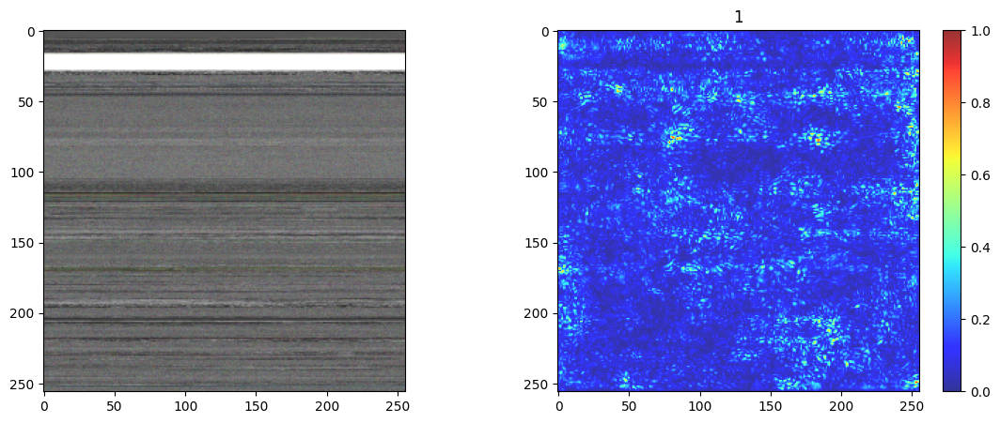

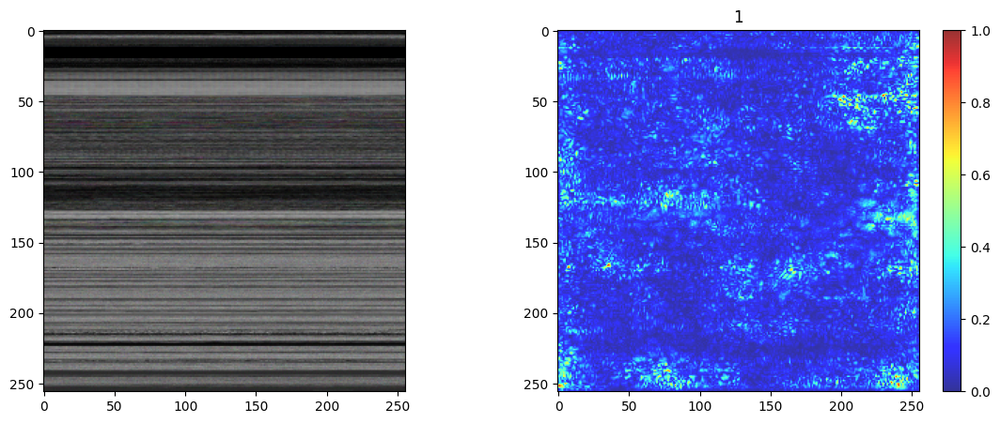

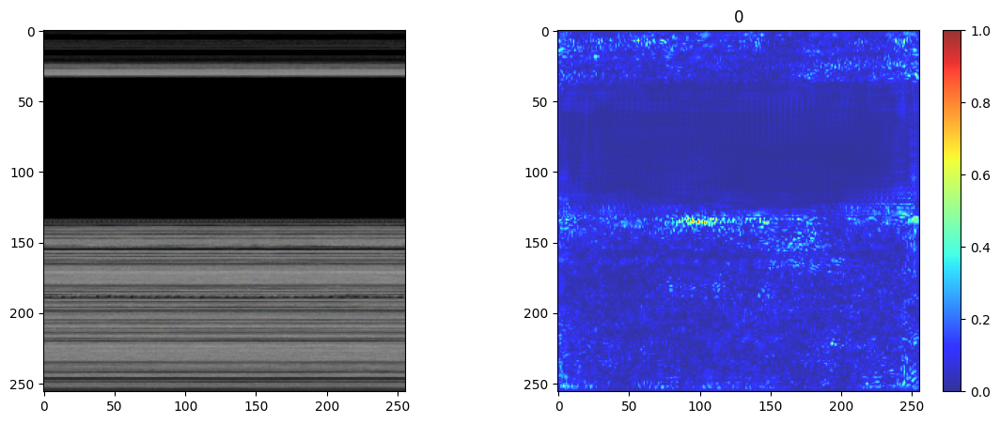

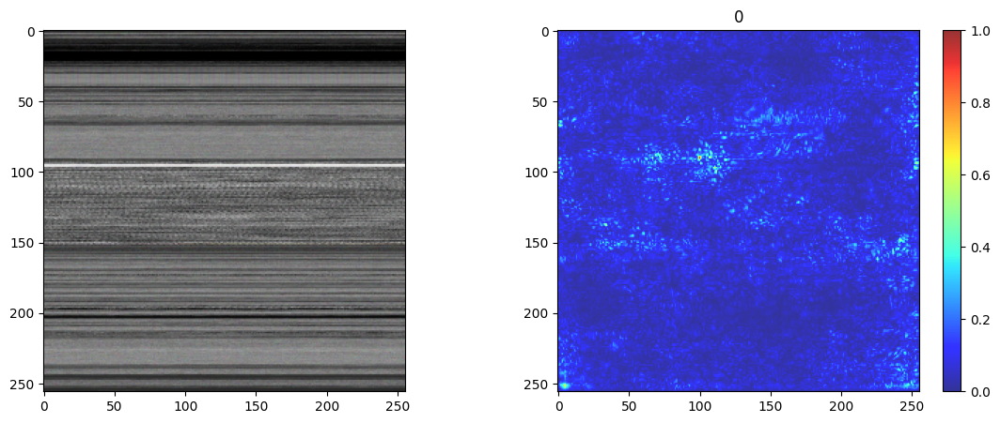

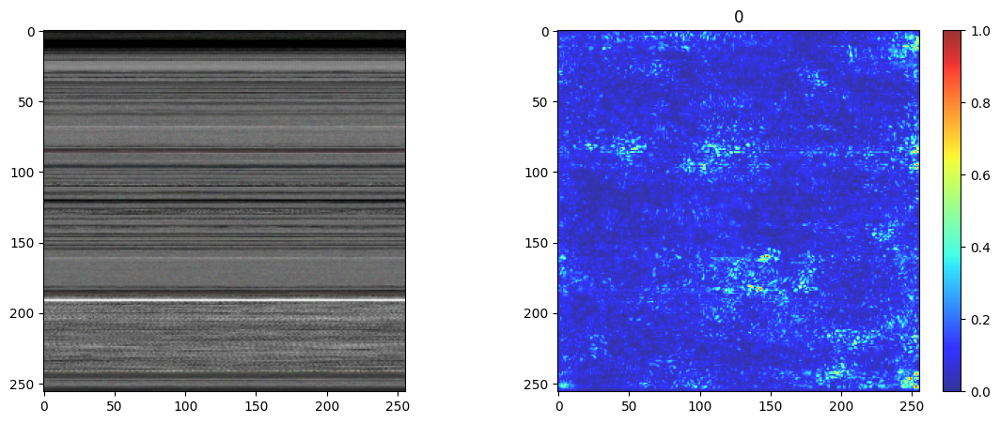

...

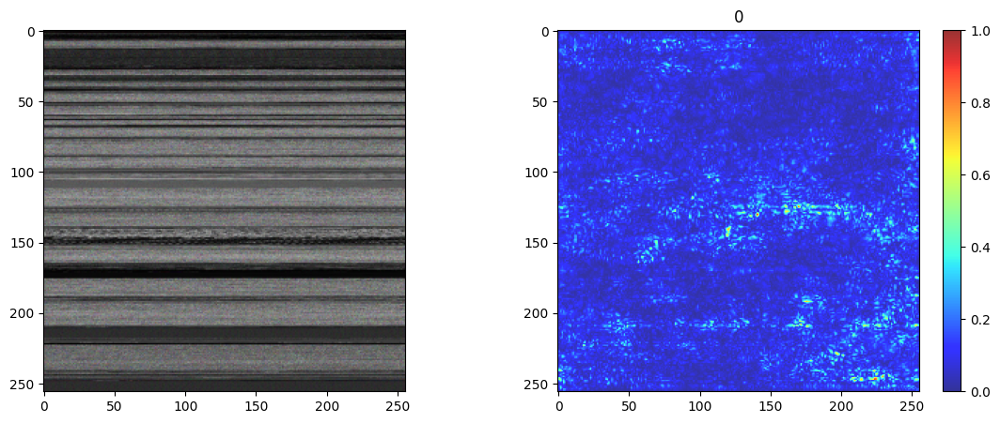

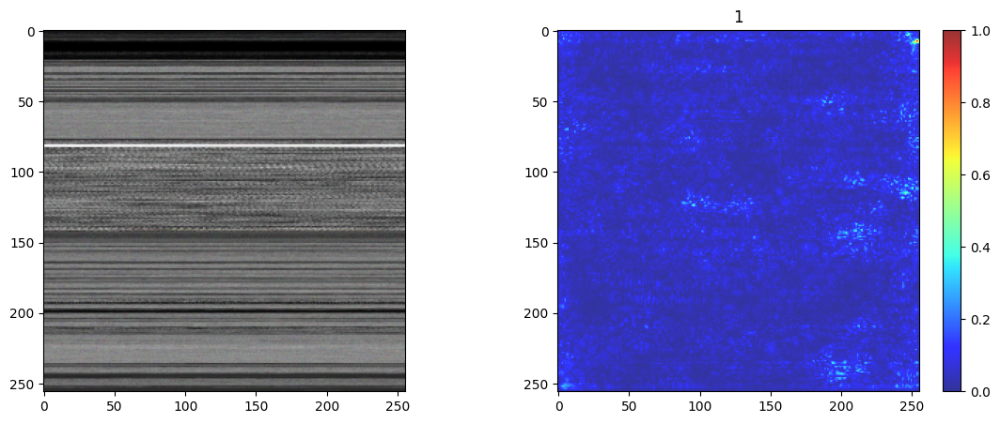

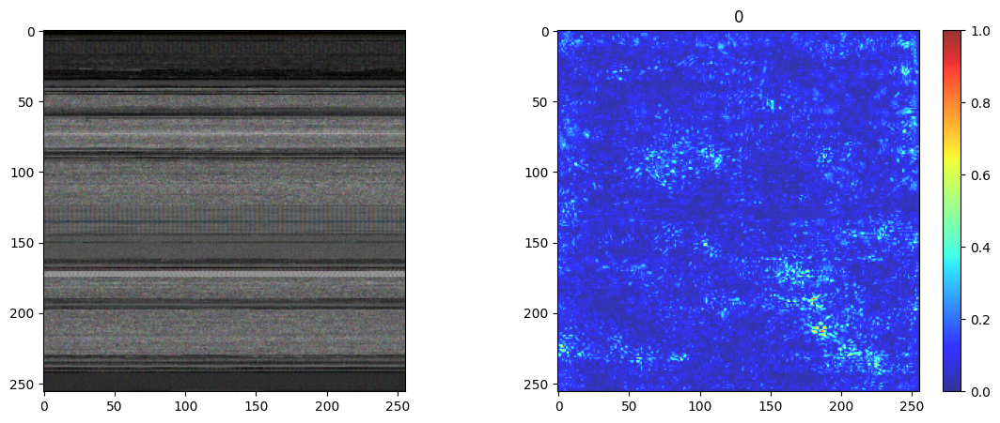

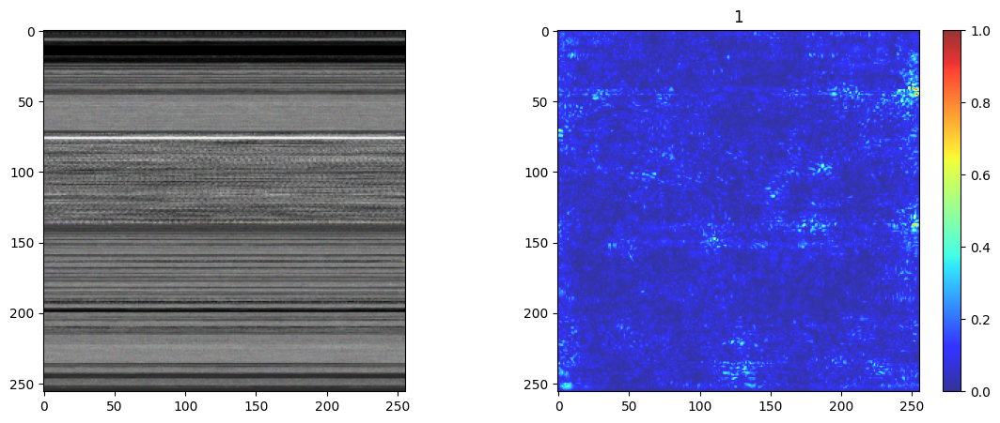

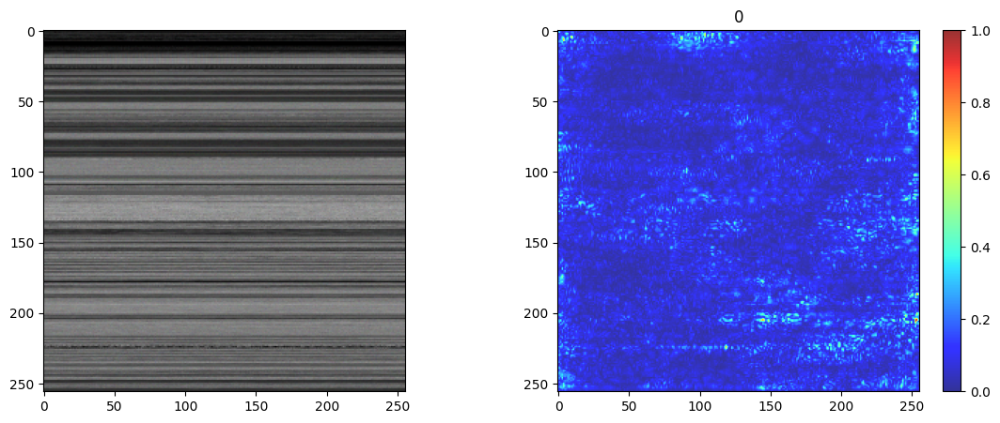

In [21]:
# icam = GradCAM(model, i, 'vgg16')
# heatmap = icam.compute_heatmap()
# heatmap = cv2.resize(heatmap, (32, 32))

# image = cv2.imread('/content/dog.jpg')
# image = cv2.resize(image, (32, 32))
# print(heatmap.shape, image.shape)

# (heatmap, output) = icam.overlay_heatmap(heatmap, image, alpha=0.5)


from google.colab.patches import cv2_imshow

# for batchx, batchy in train:
#     for i, x in enumerate(batchx):
#         x = np.asarray(x)
#         # plt.subplot(4, 4, i + 1)
#         # plt.imshow(images[i].numpy().astype("uint8"))
#         # plt.title(int(labels[i]))
#         # plt.axis("off")
#         # saliency = cv2.saliency.StaticSaliencySpectralResidual_create()
#         # (success, saliencyMap) = saliency.computeSaliency(images[i].numpy().astype("uint8"))
#         # saliencyMap = (saliencyMap * 255).astype("uint8")
#         # plt.imshow(images[i].numpy().astype("uint8"))
#         # plt.imshow(saliencyMap)
#         image = cv2_imshow(x)
#         # image = cv2.resize(image, (32, 32))
#         icam = GradCAM(vggmode, i, 'vgg16')
#         heatmap = icam.compute_heatmap(x)
#         # heatmap = cv2.resize(heatmap, (32, 32))


#         print(heatmap.shape, x.shape)
#         (heatmap, output) = icam.overlay_heatmap(heatmap, image, alpha=0.5)

for batchx, batchy in train.take(1):
      for i, x in enumerate(batchx):
        img = keras.preprocessing.image.img_to_array(x)
        img = img.reshape((1, *img.shape))
        y_pred = model.predict(img)

        images = tf.Variable(img, dtype=float)

        with tf.GradientTape() as tape:
            pred = model(images, training=False)
            class_idxs_sorted = np.argsort(pred.numpy().flatten())[::-1]
            loss = pred[0][class_idxs_sorted[0]]

        grads = tape.gradient(loss, images)
        dgrad_abs = tf.math.abs(grads)
        dgrad_max_ = np.max(dgrad_abs, axis=3)[0]


        arr_min, arr_max  = np.min(dgrad_max_), np.max(dgrad_max_)
        grad_eval = (dgrad_max_ - arr_min) / (arr_max - arr_min + 1e-18)

        fig, axes = plt.subplots(1,2,figsize=(14,5))
        plt.title(int(batchy[i]))
        axes[0].imshow(x)
        i = axes[1].imshow(grad_eval,cmap="jet",alpha=0.8)
        fig.colorbar(i)